In [ ]:
#!/usr/bin/env python
"""
Demo for STEMPO dynamic tomography test problem
--------------------------------------------------------------------------
Created in 2023 for TRIPs-Py library
"""
__authors__ = "Mirjeta Pasha, Silvia Gazzola, Connor Sanderford, and Ugochukwu Obinna Ugwu"
__affiliations__ = 'Tufts University, University of Bath, Arizona State University, and Tufts University'
__copyright__ = "Copyright 2023, TRIPs-Py library"
__license__ = "GPL"
__version__ = "1.0"
__email__ = "mirjeta.pasha@tufts.edu; mirjeta.pasha1@gmail.com; sg968@bath.ac.uk; csanderf@asu.edu; connorsanderford@gmail.com; Ugochukwu.Ugwu@tufts.edu"

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.linalg import fractional_matrix_power
from numpy import array, diag, dot, maximum, empty, repeat, ones, sum
from numpy.linalg import inv
import time
import scipy as sp
import scipy.stats as sps
import scipy.io as spio
import matplotlib
import astra
from venv import create
from scipy.ndimage import convolve
from scipy import sparse
from scipy.ndimage import convolve
import scipy.special as spe
from trips.solvers.MMGKS import *
import requests
import numpy as np
import h5py
import pylops
from trips.utilities.helpers import *
from trips.utilities.io import *
from trips.utilities.operators import *
from trips.solvers.Hybrid_LSQR import *

# Notebook 1: STEMPO test problem

<p>In this example we illustrate the following:
<p>&nbsp; Step 1: Download/read the STEMPO data and prepare them for processing.
<p>&nbsp; Step 2: Solve the static inverse problem.
<p>&nbsp; Step 3: Solve the dynamic inverse problem.

CrossPhantom data are generated at the University of Helsinki: https://zenodo.org/record/7147139

#### Step 1: Download/read the data and prepare them for processing
##### The main function to generate the emoji data is generate_crossPhantom(dataset, noise_level) 
<p> <b>Input:</b> 
<p>&nbsp; <b>dataset:</b>
        <p>&nbsp; if dataset = 15, we generate data from DataDynamic_128x15.mat
        <p>&nbsp; if dataset = 60, we generate data from DataDynamic_128x60.mat
<p>&nbsp; <b>noise_level:</b>
        <p>&nbsp; CrossPhantom data are real data and they have noise. Hence, we set noise_level = 0
            
<p> <b>Output:</b>  
&nbsp;<br> <b>A:</b> The full forward operator for all time instances<br>
&nbsp; <b>b:</b> All the data/measurements vectorized<br> 
&nbsp; <b>AA:</b> A list of 16 time-wise operators<br> 
&nbsp; <b>B:</b> A list of 16 data vectors for each time instance <br> 
&nbsp; <b>nx:</b> The dimension of the first spatial domain<br> 
&nbsp; <b>ny:</b> The dimension of the second spatial domain<br> 
&nbsp; <b>nt:</b> The dimension of the time instances domain<br> 
&nbsp; <b>delta:</b> The noise level in the data. When we set noise_level == 0, we get delta = 0<br> 
&nbsp; <b>sinoshape:</b> The dimension of the time-wise sinogram<br>     

In [7]:
(F, d, Aseq, B, nx, ny, nt, savedelta, truth) = generate_stempo(data_set = 'simulation', data_thinning = 2, noise_level = 0.01)

downloading...
Stempo data downloaded.


#### Access all the ground truth images (360 images of size 560 x 560)

In [8]:
f = spio.loadmat(f'./data/stempo_data/stempo_ground_truth_2d_b4.mat')

(-0.5, 559.5, 559.5, -0.5)

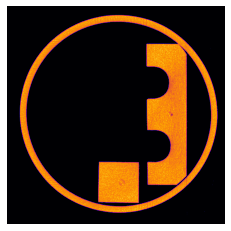

In [9]:
plt.imshow(f['obj'][:,:, 2], cmap = 'inferno')
plt.axis('off')

#### Access the ground truth images used for this experiment (see get_stempo_data on how they are choosen)

(-0.5, 559.5, 559.5, -0.5)

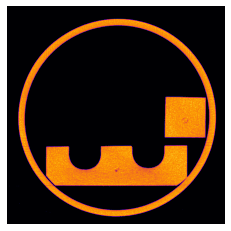

In [12]:
rotate_image = ndimage.rotate(truth[9, :, :],-90, mode='constant')
plt.imshow(rotate_image, cmap = 'inferno')
plt.axis('off')

#### Step 2: Solve the static inverse problems.
<p>&nbsp; <b>The function to perform reconstruction is reconstruct_anisoTV(dynamic)</b>
<p> <b>Input:</b> 
<p>&nbsp; <b>dynamic:</b>
        <p>&nbsp; if dynamic = True, it solves the dynamic inverse problem $A x = b$
        <p>&nbsp; if dynamic = False, it solves nt static inverse problems $AA(i) x(i) = B(i)$, for i in range(nt)
<p> <b>Output:</b>  
&nbsp;<br> <b>xx:</b> <br>If dynamic == True, xx is a 3 dimensional tensor with dimensions (nx, ny, nt) that contains nt reconstructed images<br>If dynamic == False, xx is a list with nt elements that contains nt reconstructed images

In [8]:
timestep = 9
L = spatial_derivative_operator(nx, ny, 1)
b_vec = B[timestep].reshape((-1,1))
(x, info) = MMGKS(Aseq[timestep], b_vec, L, pnorm=2, qnorm=1, projection_dim=2, n_iter = 10, regparam = 'gcv', x_true=None)


running MMGKS...: 100%|██████████| 10/10 [01:09<00:00,  6.99s/it]


(-0.5, 559.5, 559.5, -0.5)

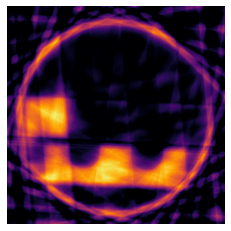

In [6]:
x[x<0] = 0
plt.imshow(x.reshape((nx, ny)))
plt.set_cmap('inferno')
plt.axis('off')

In [ ]:
xx = list(range(nt))
L = spatial_derivative_operator(nx, ny, 1)
for i in range(nt):
    b_vec = B[i].reshape((-1,1))
    (x, info) = MMGKS(AA[i], b_vec, L, pnorm=2, qnorm=1, projection_dim=3, n_iter = 2, regparam = 'gcv', x_true=None)
    xx[i] = x

running MMGKS...: 100%|██████████| 5/5 [00:32<00:00,  6.51s/it]


<Figure size 432x288 with 0 Axes>

<Figure size 3600x3600 with 0 Axes>

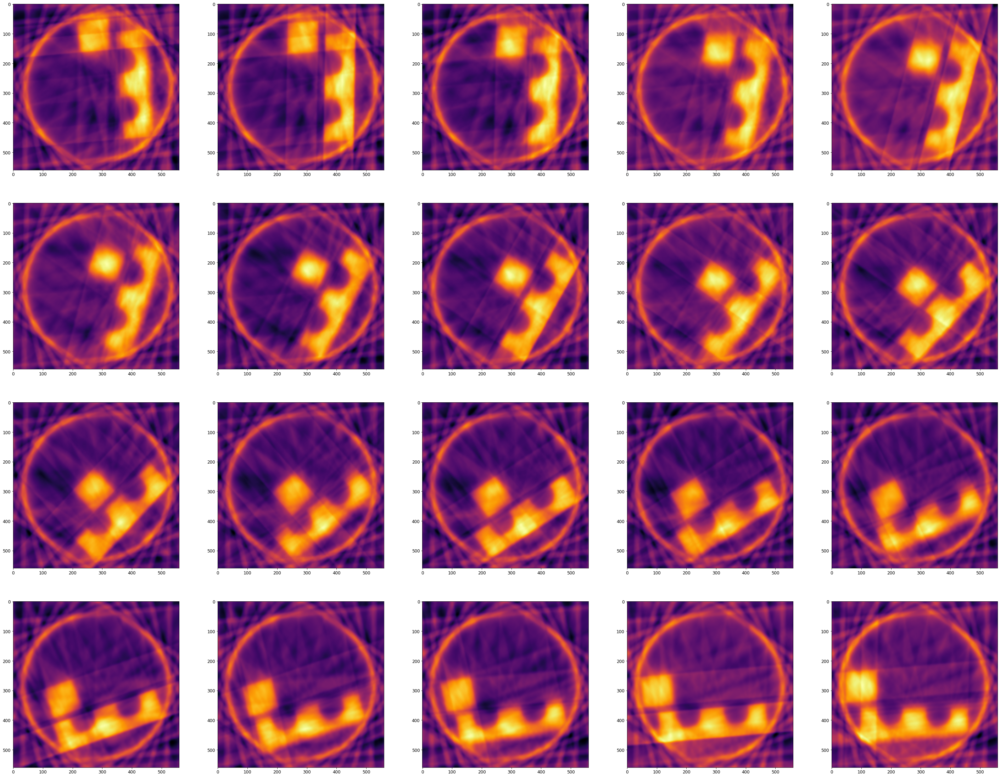

In [ ]:
plot_recstructions_series(xx, (nx, ny, nt), dynamic = False, testproblem = 'STEMPO', geome_x = 1,geome_x_small = 0,  save_imgs= False, save_path='./reconstruction/STEMPO')

### Plot reconstructions of the static problem

<Figure size 432x288 with 0 Axes>

<Figure size 3600x3600 with 0 Axes>

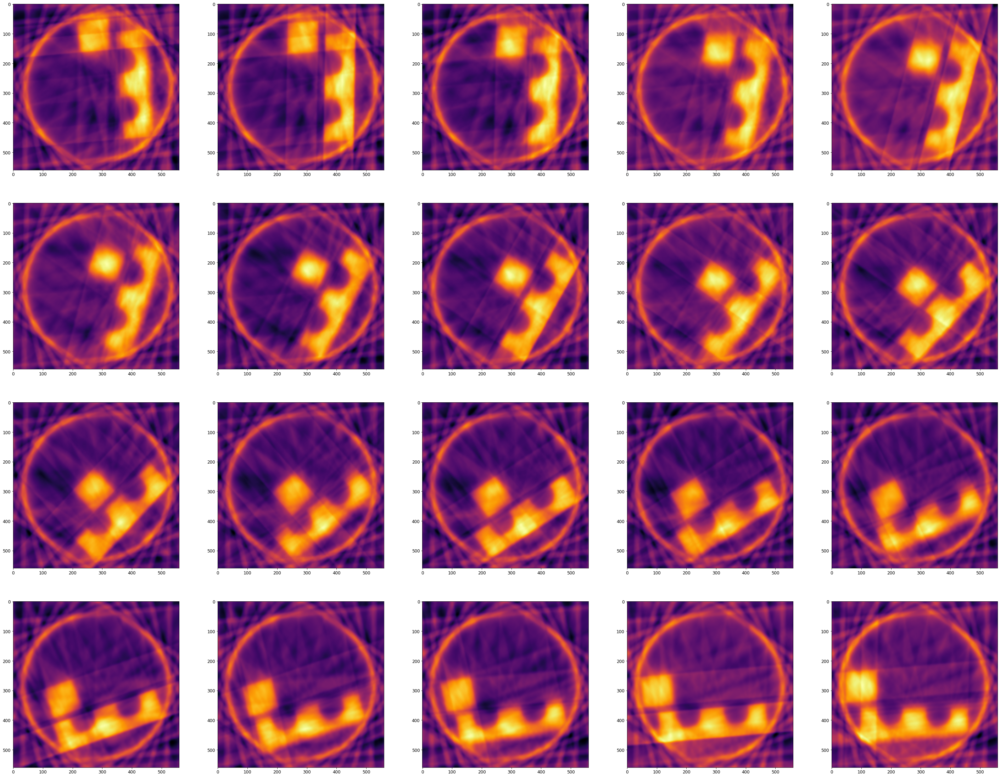

In [ ]:
plot_recstructions_series(xx, (nx, ny, nt), dynamic = False, testproblem = 'Stempo', geome_x = 1,geome_x_small = 0,  save_imgs= False, save_path='./reconstruction/Stempo')

#### Step 3: Solve dynamic inverse problems.
<p>&nbsp; <b>The function to perform reconstruction is reconstruct_anisoTV(dynamic)</b>
<p> <b>Input:</b> 
<p>&nbsp; <b>dynamic:</b>
        <p>&nbsp; if dynamic = True, it solves the dynamic inverse problem $A x = b$
        <p>&nbsp; if dynamic = False, it solves nt static inverse problems $AA(i) x(i) = B(i)$, for i in range(nt)
<p> <b>Output:</b>  
&nbsp;<br> <b>xx:</b> <br>If dynamic == True, xx is a 3 dimensional tensor with dimensions (nx, ny, nt) that contains nt reconstructed images<br>If dynamic == False, xx is a list with nt elements that contains nt reconstructed images

<Figure size 432x288 with 0 Axes>

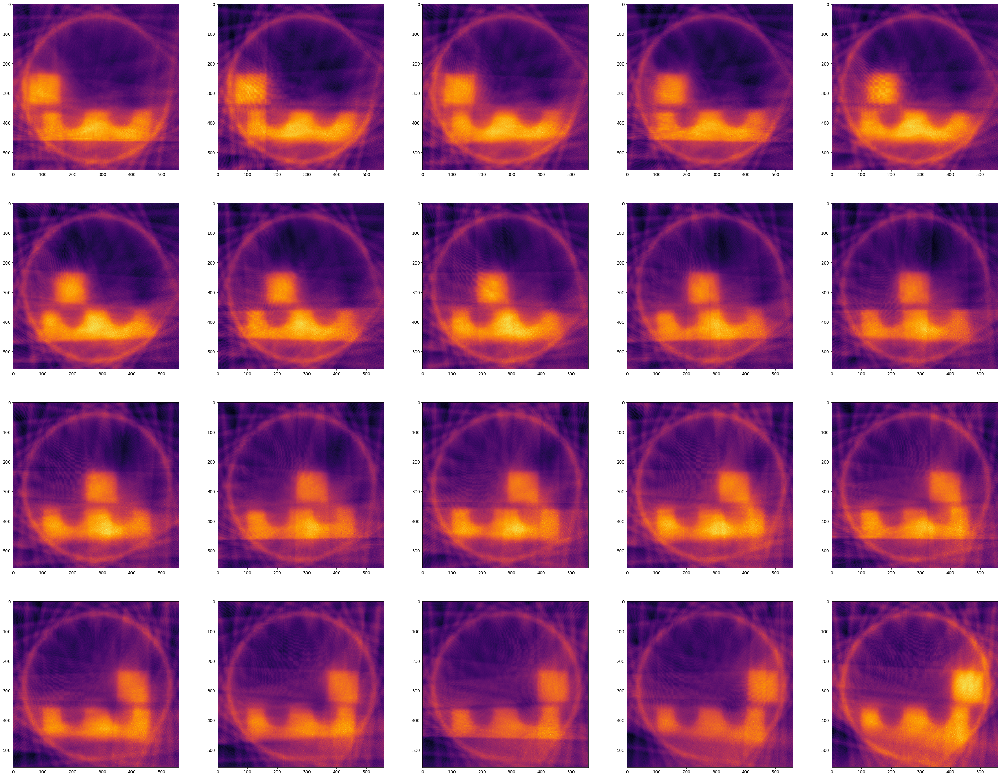

In [ ]:
plot_recstructions_series(xx, (nx, ny, nt), dynamic = True, testproblem = 'crossPhantom', geome_x = 1,geome_x_small = 0,  save_imgs = False, save_path='./reconstruction/CrossPhantom')

In [5]:
# Define the regularization operator
# L = spatial_derivative_operator(nx, ny, nt)
L = gen_spacetime_derivative_operator(nx, ny, nt)
data_vec = d.reshape((-1,1))
# Use GKS to compute an approximate solution
(x_TV_iso, info_TV_iso) = MMGKS(F, data_vec, L, pnorm=2, qnorm= 1, projection_dim=1, n_iter = 50, regparam = 'gcv', x_true = None, epsilon = 0.001, isoTV = 'isoTV', prob_dims = (nx,ny, nt))

running MMGKS...: 100%|██████████| 50/50 [53:22<00:00, 64.06s/it] 


In [8]:
x_TV_iso[x_TV_iso<0] = 0

(-0.5, 559.5, 559.5, -0.5)

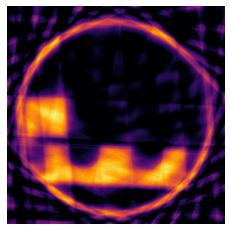

In [32]:
x_TV_iso.shape
aa = x_TV_iso.reshape((nt, nx, ny))
tmp = aa[9, :, :]
ndimage.rotate(tmp,100, mode='constant')
plt.imshow(tmp)
plt.set_cmap('inferno')
plt.axis('off')

<Figure size 432x288 with 0 Axes>

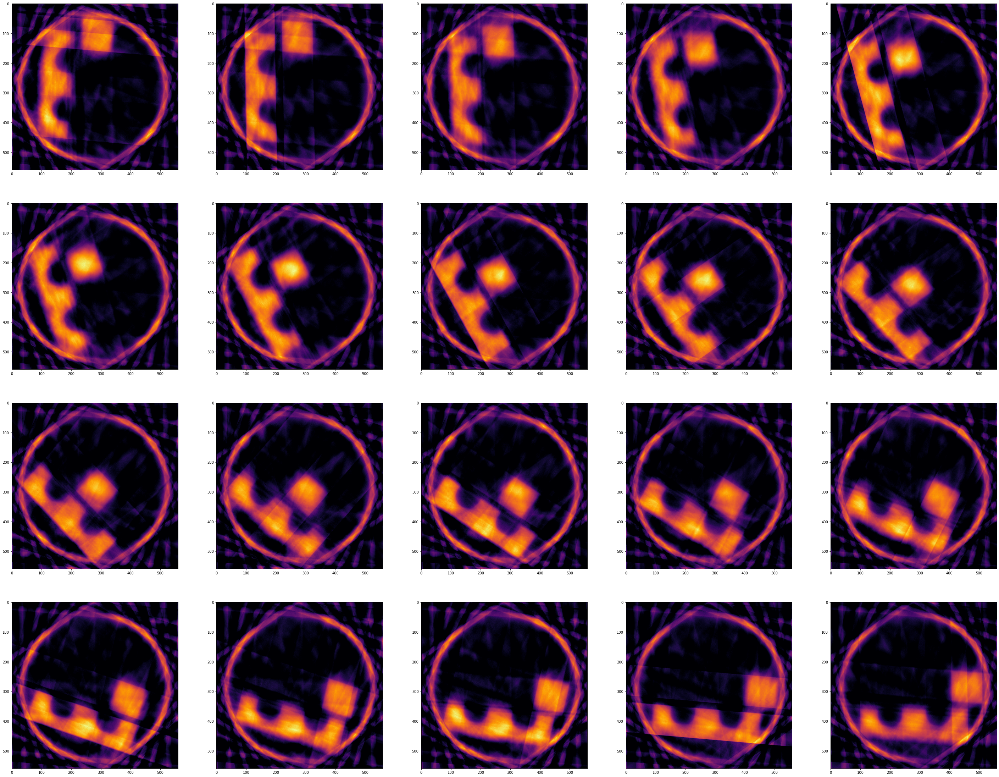

In [ ]:
plot_recstructions_series(x_TV_iso, (nx, ny, nt), dynamic = True, testproblem = 'STEMPO', geome_x = 1,geome_x_small = 0,  save_imgs = False, save_path='./reconstruction/STEMPO')

In [26]:
b_vec = d.reshape((-1,1))
(x_hybrid_lsqr, info_hybrid_lsqr) = Hybrid_LSQR(F, b_vec, n_iter = 50, regparam = 'gcv', x_true = None)

running Golub-Kahan bidiagonalization algorithm...: 100%|██████████| 50/50 [02:40<00:00,  3.20s/it]


In [28]:
x_hybrid_lsqrnn = x_hybrid_lsqr
x_hybrid_lsqrnn[x_hybrid_lsqrnn<0] = 0

<Figure size 432x288 with 0 Axes>

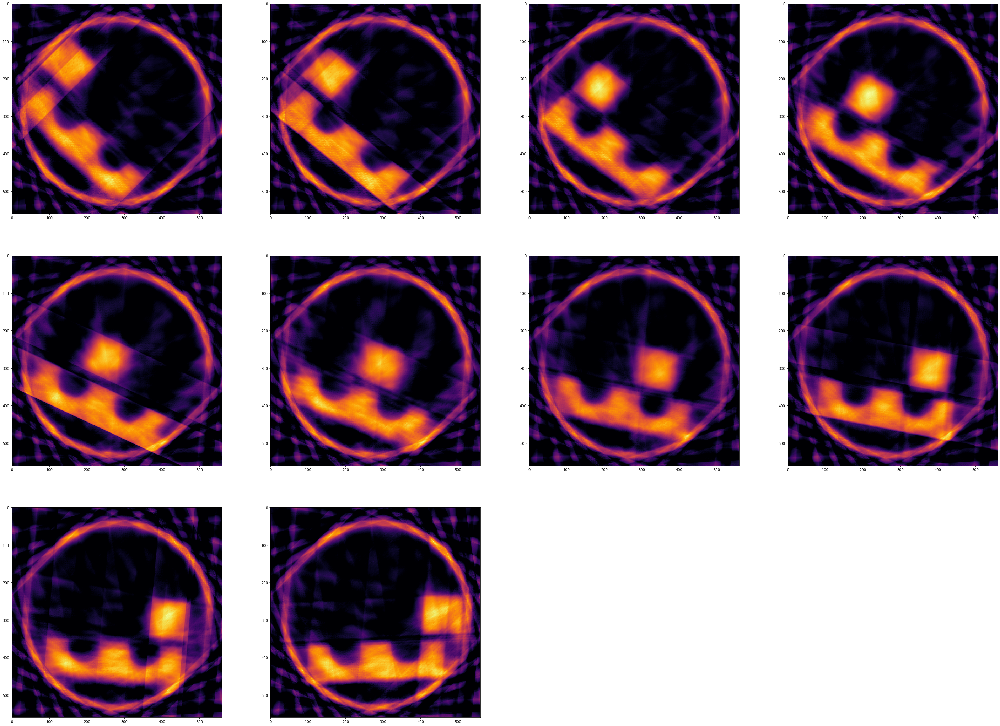

In [29]:
plot_recstructions_series(x_hybrid_lsqrnn, (nx, ny, nt), dynamic = True, testproblem = 'STEMPO', geome_x = 1,geome_x_small = 0,  save_imgs = False, save_path='./reconstruction/STEMPO')

(-0.5, 559.5, 559.5, -0.5)

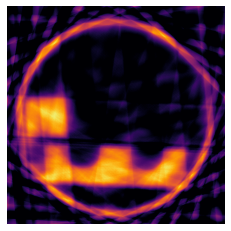

In [31]:
aa = x_hybrid_lsqrnn.reshape((nt, nx, ny))
tmp = aa[9, :, :]
ndimage.rotate(tmp,100, mode='constant')
plt.imshow(tmp)
plt.set_cmap('inferno')
plt.axis('off')

#### Step 4: Solve the problem by Golub-Kahan

generating basis...:   0%|          | 0/5 [00:00<?, ?it/s]

generating basis...: 100%|██████████| 5/5 [00:13<00:00,  2.68s/it]


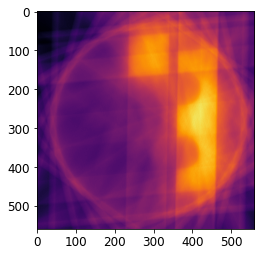

In [ ]:
b_vec = b.reshape((-1,1))
projection_dim = 5
(U, B, V) = golub_kahan(A, b_vec, projection_dim)
VV = V
UU = U[:, 0:-1]
HH = B[0:-1, :]
bhat = UU.T.dot(b_vec)
y_tikh = np.linalg.solve(HH.T*HH, bhat)
x_GKahan = VV.dot(y_tikh)
xx = np.reshape(x_GKahan, (nt, nx, ny))
xx.shape
plt.imshow(xx[1, :, :])

<Figure size 432x288 with 0 Axes>

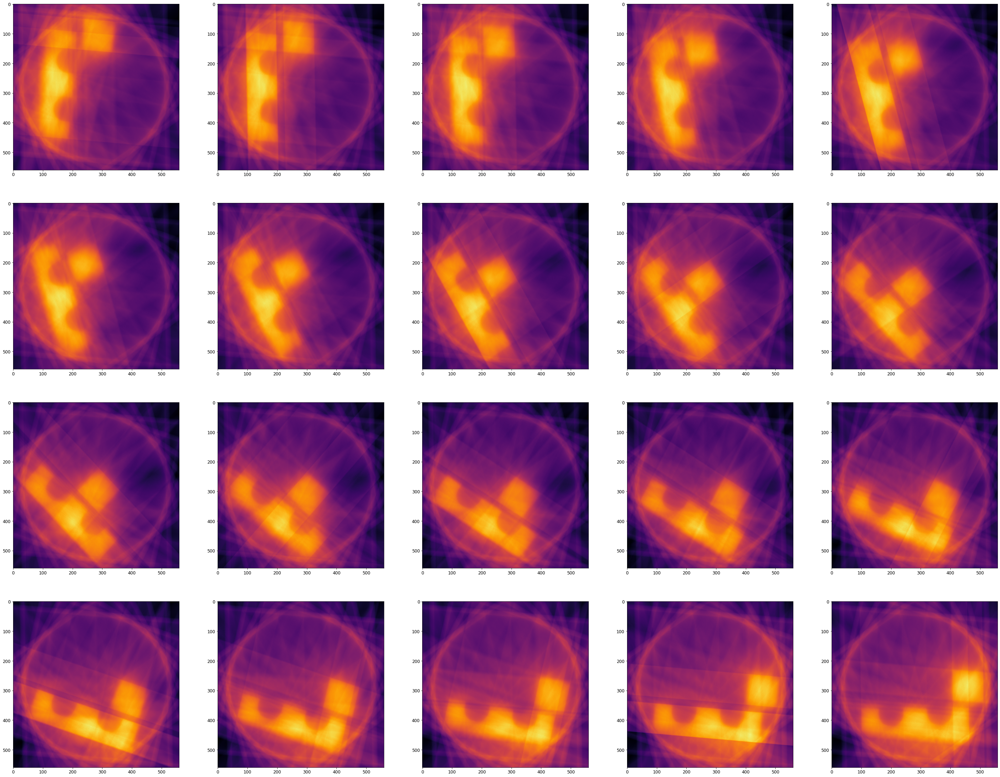

In [ ]:
plot_recstructions_series(x_GKahan, (nx, ny, nt), dynamic = True, testproblem = 'STEMPO', geome_x = 1,geome_x_small = 0,  save_imgs= False, save_path='./reconstruction/CrossPhantom')